## Exploratory Analysis - Airbnb in Toronto 2022

In [41]:
# libraries
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt 
%matplotlib inline

In [51]:
data = pd.read_csv('/Users/jjimenez/Documents/GitHub/data-science/deep-learning/rental-airbnb/toronto.csv')

In [52]:
data.head(2)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,1419,Beautiful home in amazing area!,1565,Alexandra,NaN,Little Portugal,43.6459,-79.42423,Entire home/apt,469,28,7,2017-12-04,0.09,1,0,0,NaN
1,8077,Downtown Harbourfront Private Room,22795,Kathie & Larry,NaN,Waterfront Communities-The Island,43.6408,-79.37673,Private room,96,180,169,2013-08-27,1.12,2,365,0,NaN


In [53]:
data.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365', 'number_of_reviews_ltm', 'license'],
      dtype='object')

In [54]:
# columns to analize
data = data.loc[:,[data.columns[5],data.columns[6],data.columns[7],data.columns[8],data.columns[9],
                   data.columns[10],data.columns[11],data.columns[13],data.columns[14],data.columns[15]]]

In [55]:
# Explore data
data.info()
data.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15435 entries, 0 to 15434
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   neighbourhood                   15435 non-null  object 
 1   latitude                        15435 non-null  float64
 2   longitude                       15435 non-null  float64
 3   room_type                       15435 non-null  object 
 4   price                           15435 non-null  int64  
 5   minimum_nights                  15435 non-null  int64  
 6   number_of_reviews               15435 non-null  int64  
 7   reviews_per_month               11950 non-null  float64
 8   calculated_host_listings_count  15435 non-null  int64  
 9   availability_365                15435 non-null  int64  
dtypes: float64(3), int64(5), object(2)
memory usage: 1.2+ MB


,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Little Portugal,43.64590,-79.42423,Entire home/apt,469,28,7,0.09,1,0
1,Waterfront Communities-The Island,43.64080,-79.37673,Private room,96,180,169,1.12,2,365
2,Briar Hill-Belgravia,43.69805,-79.45411,Private room,72,28,217,1.54,2,365
3,South Riverdale,43.66884,-79.32725,Entire home/apt,45,365,26,0.18,1,312
4,Waterfront Communities-The Island,43.64015,-79.37625,Entire home/apt,128,180,1,0.01,2,365


In [56]:
# Review nulls 
data[~data['reviews_per_month'].isnull()].count().values[0]
data[~data['reviews_per_month'].isnull()]
data.fillna(0,inplace=True)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15435 entries, 0 to 15434
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   neighbourhood                   15435 non-null  object 
 1   latitude                        15435 non-null  float64
 2   longitude                       15435 non-null  float64
 3   room_type                       15435 non-null  object 
 4   price                           15435 non-null  int64  
 5   minimum_nights                  15435 non-null  int64  
 6   number_of_reviews               15435 non-null  int64  
 7   reviews_per_month               15435 non-null  float64
 8   calculated_host_listings_count  15435 non-null  int64  
 9   availability_365                15435 non-null  int64  
dtypes: float64(3), int64(5), object(2)
memory usage: 1.2+ MB


In [57]:
# Check duplicate values
sum(data.duplicated())

1

In [61]:
# Drop duplicate values
data.drop_duplicates().info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15434 entries, 0 to 15434
Data columns (total 10 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   neighbourhood                   15434 non-null  object 
 1   latitude                        15434 non-null  float64
 2   longitude                       15434 non-null  float64
 3   room_type                       15434 non-null  object 
 4   price                           15434 non-null  int64  
 5   minimum_nights                  15434 non-null  int64  
 6   number_of_reviews               15434 non-null  int64  
 7   reviews_per_month               15434 non-null  float64
 8   calculated_host_listings_count  15434 non-null  int64  
 9   availability_365                15434 non-null  int64  
dtypes: float64(3), int64(5), object(2)
memory usage: 1.3+ MB


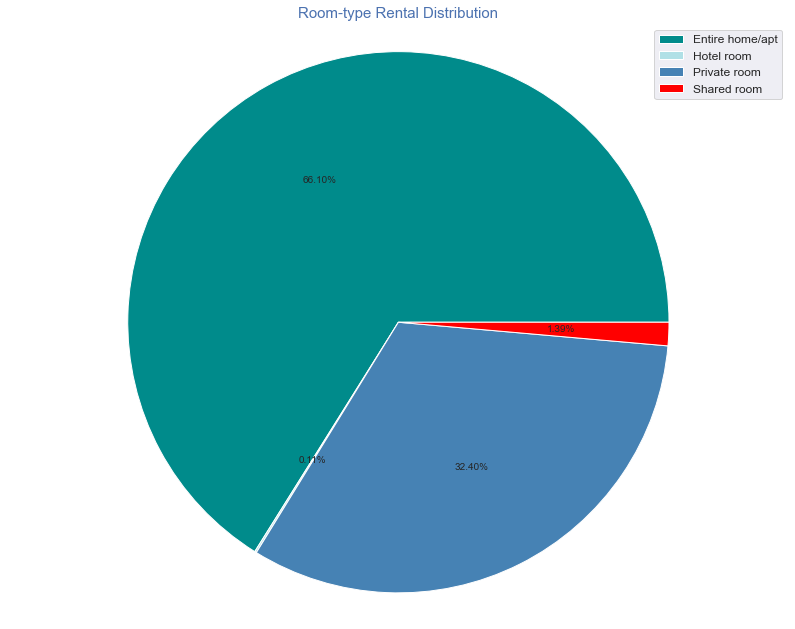

In [64]:
# Plot visualizations to understand the dataset
# 1 - Pie chart
room_type = data.groupby('room_type')['latitude'].count().reset_index()
room_type.rename(columns={'latitude':'n_rooms'},inplace=True)

plt.figure(figsize=(14,11))
plt.pie(room_type['n_rooms'],autopct='%1.2f%%', colors=['darkcyan','powderblue','steelblue', 'red'])
plt.axis('equal')
plt.legend(labels=room_type['room_type'],loc='best',fontsize='12')
plt.title('Room-type Rental Distribution', fontsize='15',color='b')
plt.savefig('image1.png')
plt.show()
plt.close()

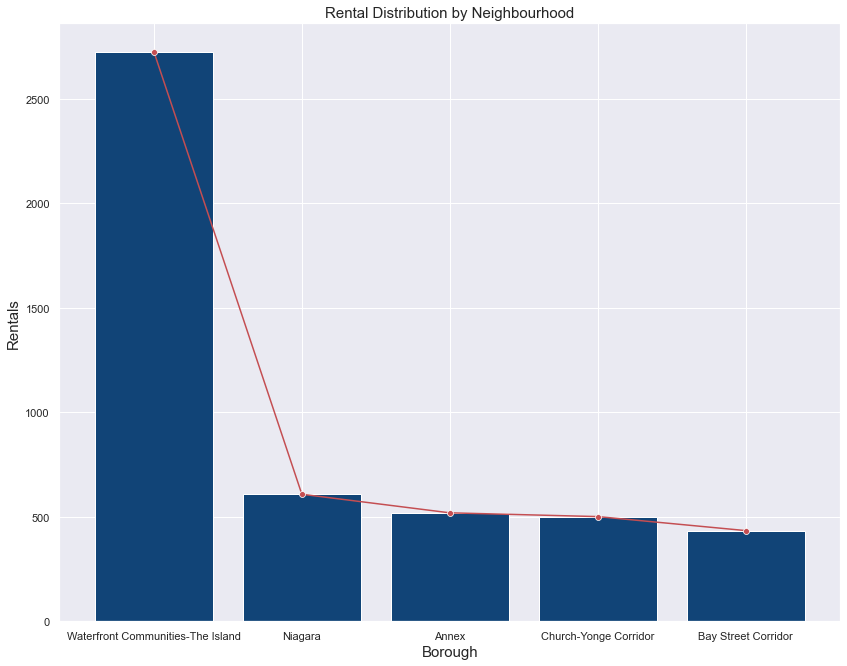

In [96]:
# 2 - Bar plot with top 5 neighbourhood distribution
neighbourhood = data.groupby('neighbourhood').count().reset_index()
neighbourhood = neighbourhood.iloc[:,0:2].sort_values('latitude', ascending=False)[0:5]

fig,ax = plt.subplots(figsize=(14,11))
sns.barplot(x=neighbourhood[neighbourhood.columns[0]],
            y=neighbourhood[neighbourhood.columns[1]],
            color='#004488',
            ax=ax)
sns.lineplot(x=neighbourhood[neighbourhood.columns[0]],
             y=neighbourhood[neighbourhood.columns[1]],
             color='r',
             marker='o',
             ax=ax)
plt.ylabel('Rentals', fontsize='15')
plt.xlabel('Borough',fontsize='15')
plt.title('Rental Distribution by Neighbourhood',fontsize='15')
plt.grid('x')
plt.savefig('image2.png')
plt.show()
sns.set()

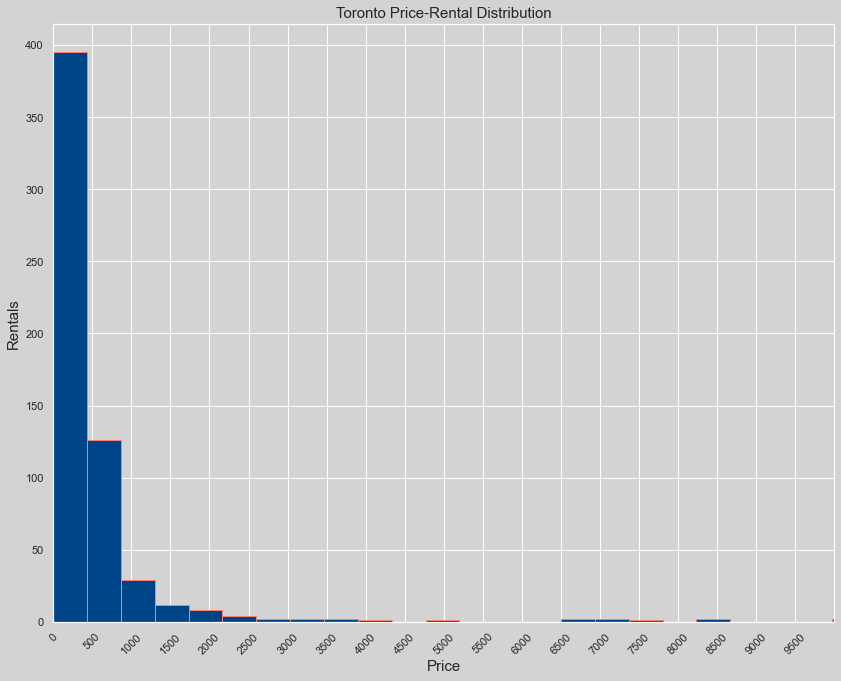

In [98]:
# 3 - Histogram plot with price distribution
price = data.loc[:,['neighbourhood','price']].set_index('neighbourhood')
price_stats = data['price'].describe().reset_index()
price_counts = price.price.value_counts().reset_index()
price_counts.rename(columns={'index':'price','price':'count'},inplace=True)

fig2,ax = plt.subplots(figsize=(14,11))
fig2.patch.set_facecolor('lightgray')
ax.set_facecolor('lightgray')
plt.hist(price_counts['price'],bins=30,color='#004488',edgecolor='salmon')
ax.set_xticks(range(0,10000,500))
for tick in ax.get_xticklabels():
    tick.set_rotation(45)
plt.xlabel('Price',fontsize='15')
plt.ylabel('Rentals', fontsize='15')
plt.xlim((-0.5,10000))
plt.title('Toronto Price-Rental Distribution',fontsize='15')
plt.savefig('image3.png')
plt.show()

In [125]:
top5_neighbourhoods = list(neighbourhood.neighbourhood.unique())

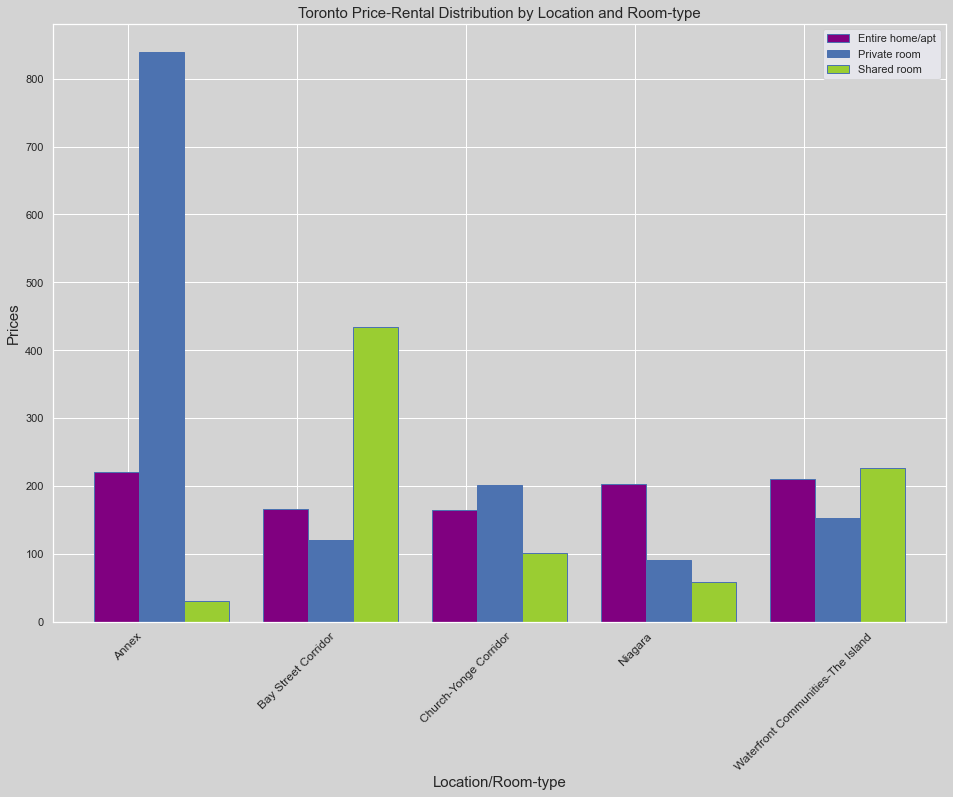

In [127]:
# 4 - Bar plot with price to location distribution
loc_price = data.groupby(['neighbourhood','room_type'])['price'].mean().reset_index()
loc_price = loc_price[loc_price['neighbourhood'].isin(top5_neighbourhoods)]
locations = loc_price.neighbourhood.unique()

x_rooms1 = [3 * element + 0.8*1 for element in range(5)]
x_rooms2 = [3 * element + 0.8*2 for element in range(5)]
x_rooms3 = [3 * element + round(0.8*3,2) for element in range(5)]
y_values1 = loc_price[loc_price['room_type'] == 'Entire home/apt']['price'].values
y_values2 = loc_price[loc_price['room_type'] == 'Private room']['price'].values
y_values3 = loc_price[loc_price['room_type'] == 'Shared room']['price'].values

fig3,ax2 = plt.subplots(figsize=(16,11))
fig3.patch.set_facecolor('lightgray')
ax2.set_facecolor('lightgray')

plt.bar(x_rooms1, y_values1, color='purple', edgecolor='b')
plt.bar(x_rooms2, y_values2, color='b', edgecolor='b')
plt.bar(x_rooms3, y_values3, color='yellowgreen', edgecolor='b')

ax2.set_xticks(range(1,16,3))
ax2.set_xticklabels(locations, fontsize='12')
for tick in ax2.get_xticklabels():
    tick.set_rotation(45)

plt.xlabel('Location/Room-type',fontsize='15')
plt.ylabel('Prices', fontsize='15')
plt.legend(labels=loc_price.room_type.unique(), loc='best')
plt.title('Toronto Price-Rental Distribution by Location and Room-type',fontsize='15')
plt.savefig('image4.png')
plt.show()

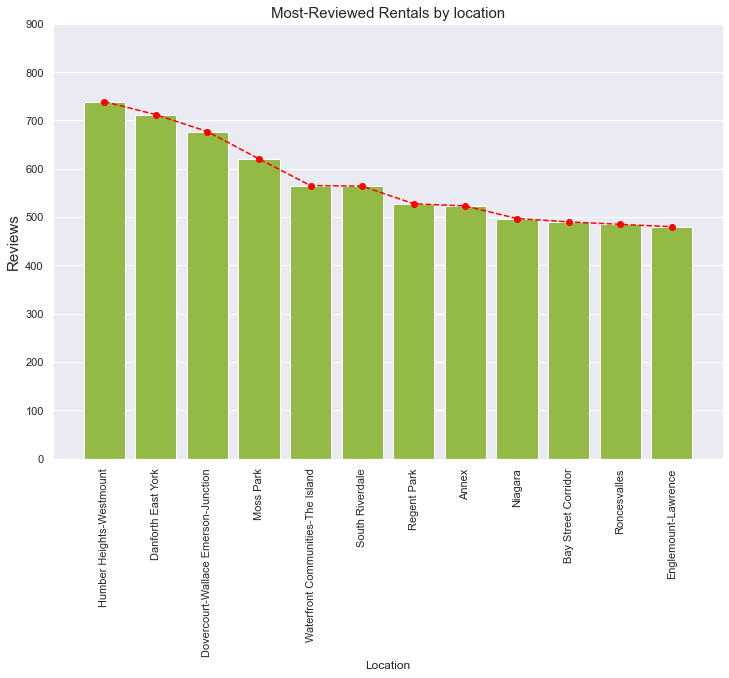

In [136]:
# 5 - Most reviewed spots
review = data.sort_values('number_of_reviews',ascending=False)
top_reviewed = review.loc[:,['neighbourhood','number_of_reviews']][:20]
top_reviewed = top_reviewed.groupby('neighbourhood').mean().sort_values('number_of_reviews',ascending=False).reset_index()

fig4,ax3 = plt.subplots(figsize=(12,8))
sns.barplot(x=top_reviewed['neighbourhood'],
            y=top_reviewed['number_of_reviews'].values,
            color='yellowgreen',
            ax=ax3)
plt.plot(top_reviewed['number_of_reviews'], marker='o', color='red',linestyle='--')
plt.ylabel('Reviews', fontsize='15')
plt.xlabel('Location',fontsize='12')
plt.ylim((0,900))
for ax in ax3.get_xticklabels():
    ax.set_rotation(90)
plt.title('Most-Reviewed Rentals by location',fontsize='15')
plt.savefig('image5.png')
plt.show()
sns.set()

In [140]:
top5_neighbourhoods

['Waterfront Communities-The Island',
 'Niagara',
 'Annex',
 'Church-Yonge Corridor',
 'Bay Street Corridor']

In [141]:
# 6 - Cheapest rental with most reviews
import numpy as np
upper_east = data[data['neighbourhood'] == 'Waterfront Communities-The Island']
ninetieth_percentile = np.quantile(upper_east['number_of_reviews'], 0.85)
upper_east = upper_east[upper_east['number_of_reviews'] >= ninetieth_percentile]
upper_east = upper_east.sort_values('price',ascending=True)

private_room = upper_east[upper_east['room_type'] == 'Private room'].reset_index()
entire_home = upper_east[upper_east['room_type'] == 'Entire home/apt'].reset_index()
shared_room = upper_east[upper_east['room_type'] == 'Shared room'].reset_index()
private_cheapest = private_room.loc[0,:].reset_index()
private_cheapest.rename(columns={'index':'data','0':'values'},inplace=True)
entire_cheapest = entire_home.loc[0,:].reset_index()
entire_cheapest.rename(columns={'index':'data','0':'values'},inplace=True)

entire_cheapest

,data,0
0,index,5788
1,neighbourhood,Waterfront Communities-The Island
2,latitude,43.64101
3,longitude,-79.39844
4,room_type,Entire home/apt
5,price,68
6,minimum_nights,90
7,number_of_reviews,101
8,reviews_per_month,2.28
9,calculated_host_listings_count,1


In [150]:
data.head(2)

,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Little Portugal,43.6459,-79.42423,Entire home/apt,469,28,7,0.09,1,0
1,Waterfront Communities-The Island,43.6408,-79.37673,Private room,96,180,169,1.12,2,365


In [151]:
# drop columns
data = data.drop(['latitude', 'longitude'], axis=1)

In [154]:
data.head(2)

,neighbourhood,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,Little Portugal,Entire home/apt,469,28,7,0.09,1,0
1,Waterfront Communities-The Island,Private room,96,180,169,1.12,2,365


In [162]:
neigh_prop = data['neighbourhood'].value_counts() / data.shape[0] * 100

In [173]:
neigh_prop = pd.DataFrame(neigh_prop.cumsum())

In [184]:
neigh_prop.insert(0, "id", range(1, 1 + len(neigh_prop)))

In [190]:
neigh_prop

,id,neighbourhood
Waterfront Communities-The Island,1,17.661160
Niagara,2,21.600259
Annex,3,24.962747
Church-Yonge Corridor,4,28.208617
Bay Street Corridor,5,31.020408
...,...,...
Guildwood,136,99.773243
Markland Wood,137,99.844509
Kingsway South,138,99.909297
Humbermede,139,99.967606


In [191]:
# how many neighbourhoods cumulate 80% of data?
neigh_prop[neigh_prop['neighbourhood'] <= 80]

,id,neighbourhood
Waterfront Communities-The Island,1,17.661160
Niagara,2,21.600259
Annex,3,24.962747
Church-Yonge Corridor,4,28.208617
Bay Street Corridor,5,31.020408
Trinity-Bellwoods,6,33.670230
Dovercourt-Wallace Emerson-Junction,7,36.196955
Kensington-Chinatown,8,38.587626
Moss Park,9,40.926466
Willowdale East,10,43.181082


In [192]:
# Encoding 
neigh_dummy = pd.get_dummies(data[['neighbourhood']])
room_dummy = pd.get_dummies(data[['room_type']])

In [194]:
# Concatenate
new_data = pd.concat([neigh_dummy, room_dummy, data], axis=1)

In [199]:
# drop categorical columns
new_data = new_data.drop(['neighbourhood', 'room_type'], axis=1)

In [200]:
# split the data
y = new_data['price']
X = new_data.drop('price', axis=1)

In [201]:
X

,neighbourhood_Agincourt North,neighbourhood_Agincourt South-Malvern West,neighbourhood_Alderwood,neighbourhood_Annex,neighbourhood_Banbury-Don Mills,neighbourhood_Bathurst Manor,neighbourhood_Bay Street Corridor,neighbourhood_Bayview Village,neighbourhood_Bayview Woods-Steeles,neighbourhood_Bedford Park-Nortown,...,neighbourhood_Yorkdale-Glen Park,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,28,7,0.09,1,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,180,169,1.12,2,365
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,28,217,1.54,2,365
3,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,365,26,0.18,1,312
4,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,180,1,0.01,2,365
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15430,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,0,0.00,1,88
15431,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,0,0.00,3,82
15432,0,0,0,0,0,0,0,0,1,0,...,0,1,0,0,0,5,0,0.00,3,175
15433,0,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,28,0,0.00,14,119


In [212]:
X = X.values
y = y.values

In [213]:
y

array([469,  96,  72, ...,  81,  70, 158])

In [214]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [215]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(10341, 149)
(5094, 149)
(10341,)
(5094,)


In [216]:
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score

In [217]:
# define base model
def baseline_model():
    # create model
    model = Sequential()
    model.add(Dense(13, input_dim=13, kernel_initializer='normal', activation='relu'))
    model.add(Dense(1, kernel_initializer='normal'))
    # Compile model
    model.compile(loss='mean_squared_error', optimizer='adam')
    return model

In [232]:
estimator = KerasRegressor(build_fn=baseline_model, epochs=50, batch_size=5, verbose=0)
kfold = KFold(n_splits=10341)
results = cross_val_score(estimator, X_train, y_train, cv=kfold)

/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
10341 fits failed out of a total of 10341.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/wrappers/scikit_learn.py", line 166, in fit
    history = self.model.fit(x, y, **fit_args)
  File "/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py", line 1100, in fit
    tmp_logs = self.train_function(iterat

In [218]:
print("Baseline: %.2f (%.2f) MSE" % (results.mean(), results.std()))

Baseline: nan (nan) MSE


/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning: 
10 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "/anaconda3/lib/python3.7/site-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/wrappers/scikit_learn.py", line 166, in fit
    history = self.model.fit(x, y, **fit_args)
  File "/anaconda3/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py", line 1100, in fit
    tmp_logs = self.train_function(iterator)
  

In [ ]:
#An option: Categorized data into cheap, medium, expensive rooms